# Time Series project : Wavelet transform utilisation for ECG denoising

#### Samy Hocine
#### Samuel Bazaz

This project is based on the article  **"Wavelet transform application for/in non-stationary time-series analysis: A review"** of M.Rhif, A.Ben Abbes, IR.Farah, B.Martínez, Y.Sang

This article presents state of the art of wavelet transform applications in many fields such as medicine for several tasks. Our study focuses on the application of the wavelet transform for denoising ECG signals.
To deal with the wavelet transforms, we will use a library named PyWavelet. 
The data used here is **TB-XL ECG database** and the data processing is in the **Appendix Data selection** part of the notebook.
Also for more plots on wavelets see **Appendix Wavelets**.

## Initialization

### Package installing and imports

In [16]:
!pip install -r requirements.txt

  Using cached prettytable-3.9.0-py3-none-any.whl.metadata (26 kB)


In [17]:
############
# Packages #
############
import os
import sys
import pickle
import pywt
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import seaborn as sns
import matplotlib.pyplot as plt

from pathlib import Path
from itertools import product
from sklearn.metrics import mean_squared_error
from prettytable import PrettyTable
from typing import Dict, Union, List, Tuple, Any, Callable, Optional
pio.renderers.default = "plotly_mimetype+notebook"

### Data loading

In [11]:
################################
#          Data loading        #
################################
root_path = Path(os.getcwd())

###!!!!!!!!! TO ADAPT!!!!!!!!!!!!!!!!!
load_path = root_path.joinpath("outputs")
###!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

with open(str(load_path.joinpath("signals0.pkl")), "rb") as f:
    signals0 = pickle.load(f)

with open(str(load_path.joinpath("meta_data.pkl")), "rb") as f:
    df_sub = pickle.load(f)

signal = signals0[0]
scales = np.arange(1, 1024, 8)

### Plotting functions 

In [5]:
###################
#   ploting st    #
###################
#Color
def my_pal(n):
    return sns.color_palette("Spectral", n).as_hex()

#Simple
def plot_signal(vec, title = "signal"):
    fig = px.line(vec, template = "plotly_dark", title = title)
    fig.show()

def plot_all_st(X, clustering=None, title="<b>Signals</b>"):
    """
    Plot multiple signals in a single interactive Plotly figure.

    Args:
        X (list of arrays): A list of signal arrays to be plotted.
        clustering (list or None, optional): A list of cluster assignments for each signal. 
            If provided, signals will be color-coded by cluster. Default is None.
        title (str, optional): The title of the plot. Default is "<b>Signals</b>".

    Returns:
        None: Displays an interactive Plotly figure with the plotted signals.
    """
    
    fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=800, 
            template = "plotly_dark", 
            title = title
    ))
        
    if clustering:
        pal = ["palegreen", "darkred"]
    else:
        pal = sns.color_palette("Spectral", len(X)).as_hex()

    for i in range(len(X)):
        if clustering:
            color = pal[clustering[i]]
        else:
            color = pal[i]
            
        fig.add_trace(go.Scatter(y=X[i], 
                                 mode="lines", 
                                 line=dict(
                                     width=2,
                                     color=color,
                                 ),
                                 opacity = 0.6
                                ))
    fig.show()

# Constructor
def add_fig(fig, signal, color, name):
    fig.add_trace(go.Scatter(y=signal, 
                 mode="lines", 
                 line=dict(
                     width=2,
                     color=color,
                 ),
                 opacity = 0.6,
                 name=name
                )
             )
    

#Two signals compairison
def plot_estim(xb, true_x, title = "estimate xbar"):
    fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=800, 
            template = "plotly_dark", 
            title = title
    ))
    pal = my_pal(4)

    add_fig(fig, xb, "darkorchid" ,f"Estimation")
    add_fig(fig, true_x, "palegreen" ,f"Signal")
    fig.show()

##################
#   Scalogram    #
##################
def plot_scalogram(sig, scales, 
                 waveletname = 'cmor', 
                 levels = np.linspace(1e-1, 3, 40),
                 title = 'Scalogram of signal', 
                 fs = 500,
                 cmap = plt.cm.plasma, 
                 ):
    plt.clf()
    dt = 1/fs
    n = sig.shape[0]
    time = np.arange(0, n)/fs
    [coefficients, frequencies] = pywt.cwt(sig, scales, waveletname, dt)
    power = (abs(coefficients)) ** 2
    period = 1. / frequencies

    
    contourlevels = np.log2(levels)
    
    fig, ax = plt.subplots(figsize=(6, 5))
    im = ax.contourf(time, np.log2(period), np.log2(power), contourlevels, extend='both',cmap=cmap)
    
    ax.set_title(title, fontsize=10)
    ax.set_ylabel("Log period (s)", fontsize=8)
    
    ax.set_xlabel("Time (s)", fontsize=8)
    
    yticks = 2**np.arange(np.ceil(np.log2(period.min())), np.ceil(np.log2(period.max())))

    ax.set_yticks(np.log2(yticks))
    ax.set_yticklabels(yticks)

    ax.invert_yaxis()
    ylim = ax.get_ylim()
    ax.set_ylim(ylim[0], -1)


def plot_scalogram_freq(sig, scales, 
                 waveletname = 'cmor', 
                 levels = np.linspace(1e-1, 3, 40),
                 title = 'Scalogram of signal', 
                 fs = 500,
                 cmap = plt.cm.plasma, 
                 ):
    plt.clf()
    dt = 1/fs
    n = sig.shape[0]
    time = np.arange(0, n)/fs
    [coefficients, frequencies] = pywt.cwt(sig, scales, waveletname, dt)
    power = (abs(coefficients)) ** 2

    contourlevels = np.log2(levels)
    
    fig, ax = plt.subplots(figsize=(6, 5))
    im = ax.contourf(time, np.log2(frequencies), np.log2(power), contourlevels, extend='both',cmap=cmap)
    
    ax.set_title(title, fontsize=10)
    ax.set_ylabel("Log2 Frequencies (f)", fontsize=8)
    
    ax.set_xlabel("Time (s)", fontsize=8)
    
    yticks = 2**np.arange(np.ceil(np.log2(frequencies.min())), np.ceil(np.log2(frequencies.max())))

    ax.set_yticks(np.log2(yticks))
    ax.set_yticklabels(yticks)

    ax.invert_yaxis()
    ylim = ax.get_ylim()
    ax.set_ylim(ylim[0], -1)

    plt.show()

####################################
#   Wavelet mothers and Fathers    #
####################################

def add_fig_continuous(level, w, fig, signal, color, wave):
    psi, x = w.wavefun(level=level)
    if not w.complex_cwt:
        add_fig(fig, psi, color, f"{wave} wavelet continuous function psi")
    else:
        add_fig(fig, np.real(psi), color, f"{wave} wavelet continuous function psi real part")

def add_fig_discret_ortho(level, w, fig, signal, color, wave):
    (phi, psi, x) = w.wavefun(level=level)
    add_fig(fig, phi, color, f"{wave} scaling function phi")
    add_fig(fig, psi, color, f"{wave} wavelet function psi")

def add_fig_discret_biortho(level, w, fig, signal, color, wave):
    (phi_d, psi_d, phi_r, psi_r, x) = w.wavefun(level=level)
    add_fig(fig, phi_d, color, f"{wave} decomposition scaling phi_d")
    add_fig(fig, psi_d, color, f"{wave} decomposition wavelet psi_d")
    add_fig(fig, phi_r, color, f"{wave} reconstruction scaling phi_r")
    add_fig(fig, psi_r, color, f"{wave} reconstruction wavelet psi_r")

def plot_one_wave(level, type, iscontinous = False):
    pal = my_pal(5)
    fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=800, 
            template = "plotly_dark", 
            title = f"Wavelets {type}"
    ))
    
    wave = type
    print(wave)
    w = pywt.DiscreteContinuousWavelet(wave)
    if iscontinous:
        # w = pywt.ContinuousWavelet(wave)
        add_fig_continuous(level, w, fig, signal, pal[0], wave)
    else:
        # w = pywt.Wavelet(wave)
        if w.orthogonal:
            add_fig_discret_ortho(level, w, fig, signal, pal[0], wave)
        else:
            add_fig_discret_biortho(level, w, fig, signal, pal[0], wave)
    fig.update_layout(title = w.family_name + f" code={type}  level = {level} ")
    fig.show()    

def plot_wave_family(level, type, iscontinous = False):
    lst_wave = pywt.wavelist(type)
    nwave = len(lst_wave)
    pal = my_pal(nwave)
    fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=800, 
            template = "plotly_dark", 
            title = f"Wavelets {type}"
    ))
    
    for i in range(nwave):
        wave = lst_wave[i]
        w = pywt.DiscreteContinuousWavelet(wave)
        if iscontinous:
            # w = pywt.ContinuousWavelet(wave)
            add_fig_continuous(level, w, fig, signal, pal[i], wave)
        else:
            # w = pywt.Wavelet(wave)
            if w.orthogonal:
                add_fig_discret_ortho(level, w, fig, signal, pal[i], wave)
            else:
                add_fig_discret_biortho(level, w, fig, signal, pal[i], wave)

    fig.update_layout(title = w.family_name + f" code={type}  level = {level} ")
    fig.show()

##################
#   DWT plots    #
##################

def plot_decomposition(wave, title=f"Wavelets multilevel reconstruction"):
    coeffs = pywt.wavedec(signal, w)
    fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=800, 
            template = "plotly_dark", 
            title = title
    ))
    pal = my_pal(len(coeffs))
    
    coeffs2 = [np.zeros_like(coeff) for coeff in coeffs]

    for i,coeff in enumerate(coeffs):
        coeffs2[i] = coeff
        add_fig(fig, pywt.waverec(coeffs2, wave), pal[i] ,f"add coeff {i}")
    fig.show()

## Denoising Study

We'll be focusing on different methods using the discrete wavelet transform for signal compression or denoising. The general approach is to calculate the coefficients of a discrete wavelet transform (DWT) of the original signal, then use a threshold to retain only the coefficients of the highest norm. In this way, we aim to retain most of the relevant information and remove the noise.

We will compare different methods of signal denoising. The main parameters of wavelet filtering are : 
- The mother wavelet
- The thresholding method 
- Thresholding parameters

We present each threshold method and compare different mother wavelets and threshold values. To estimate whether a reconstructed signal has retained the relevant information and removed the noise, we'll use a graphical criterion.

### Wavelet Selection 

The first step is to study the various possible decomposition bases. To illustrate the effect of the choice of the mother wavelet, we can take the example of the Haar and Daubechies bases. See the Appendix to have a complete view on the existing bases.

haar


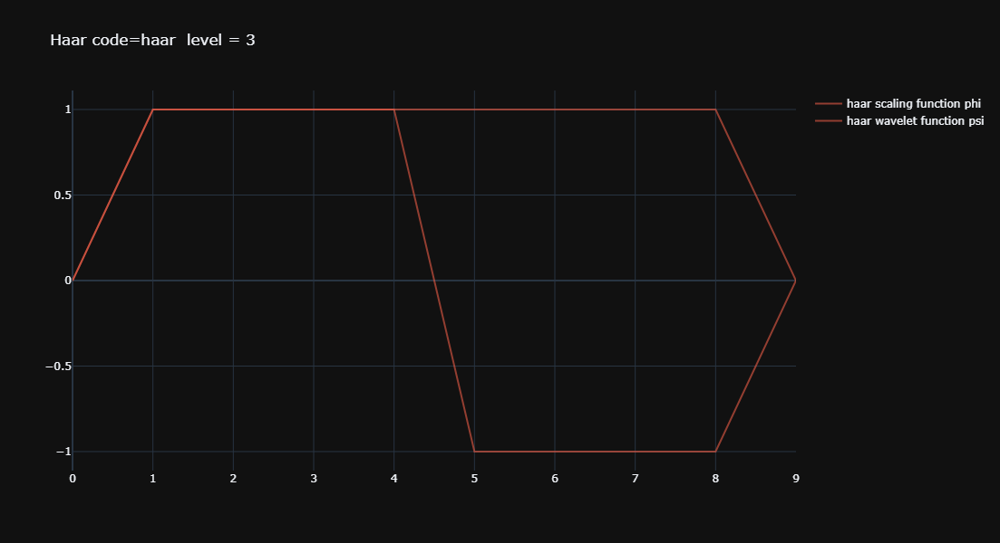

In [6]:
wavename = "haar"
plot_one_wave(level=3, type=wavename)

db5


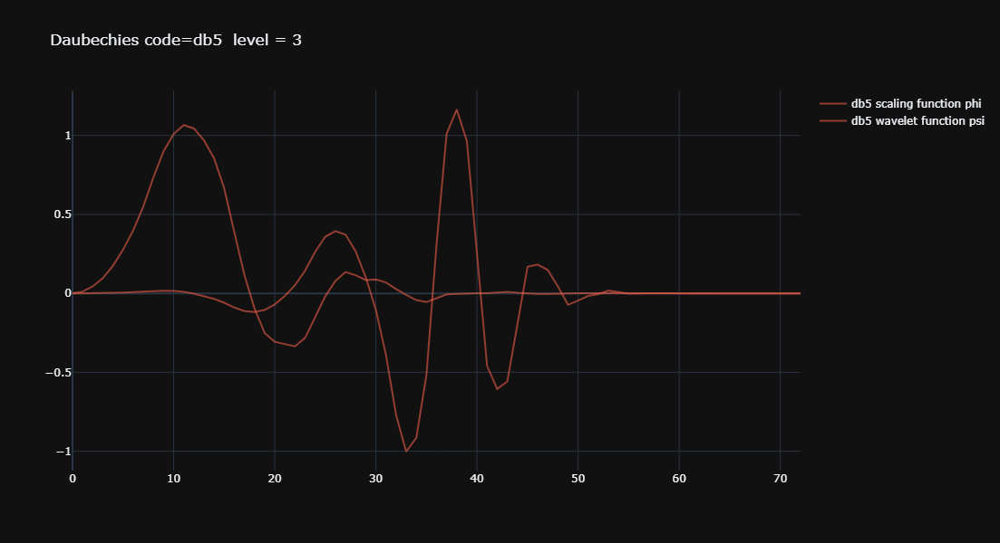

In [7]:
wavename = "db5"
plot_one_wave(level=3, type=wavename)

### The Data 

The signal of the first electrode of the first patient is as follow.

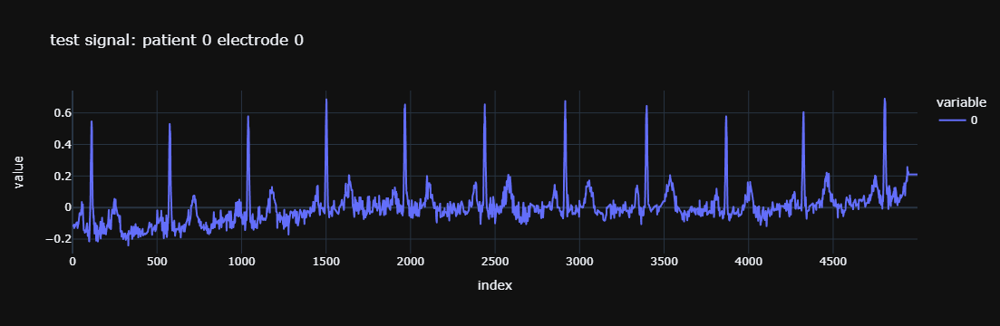

In [8]:
plot_signal(signal, title = "test signal: patient 0 electrode 0")

C:\Users\samud\anaconda3\envs\MVA\lib\site-packages\pywt\_cwt.py:117: FutureWarning:

Wavelets from the family cmor, without parameters specified in the name are deprecated. The name should takethe form cmorB-C where B and C are floats representing the bandwidth frequency and center frequency, respectively (example: cmor1.5-1.0).

C:\Users\samud\AppData\Local\Temp\ipykernel_26024\3297400880.py:141: RuntimeWarning:

divide by zero encountered in log2



<Figure size 640x480 with 0 Axes>

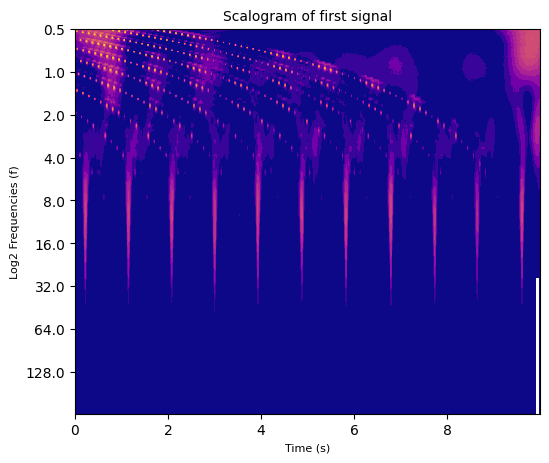

In [12]:
plot_scalogram_freq(signal, scales, waveletname = 'cmor', title = f"Scalogram of first signal", levels = np.linspace(1e-1, 3, 40))

As you can see, R singularities repeat periodically for frequencies slightly above 1Hz.
The Frequency Scalogram detects periodic patterns up to 16Hz, which may correspond to P and T patterns. Above 16Hz, a repetition of very high-frequency patterns appears: this is maybe our noise. The scalograme gives the square of the modulus of the wavelet transforms which is the equivalent of the power spectrum.

To see all the signals please run the following cell:

In [ ]:
fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=800, 
            template = "plotly_dark", 
            title = f"Signals 500Hz electrode 0"
    ))
pal = my_pal(signals0.shape[0])

for i,sign in enumerate(signals0):
    diag = df_sub.iloc[i,6]
    add_fig(fig, sign, pal[i] ,f"{diag}")
fig.show()

### Different metrics used

Certain quantitative metrics can be used to help us select a denoising method. However, only a qualitative assessment of the reconstruction in relation to the diagnostic methods can lead to truly relevant denoising.
- **peak signal-to-noise ratio (PSNR)** is used in image denoising and compare MSE to the maximum intensity
- **normalised_mse** compares the MSE to signal standard error
- **compression_ratio** compares the size of the original signal to its representation. It is a measure of compression.
- **zero_ratio_tun_moe** gives the proportion of zeros in the representation, and thus give a measure of sparsity.

In [35]:
def calculate_psnr(signal, newsignal):
    """"Calculating peak signal-to-noise ratio (PSNR) between two signals."""
    mse = np.mean((signal - newsignal) ** 2)
    if mse == 0:
        return 100
    return np.round(20 * np.log10(max(signal) / (np.sqrt(mse))),1)

def compression_ratio(signal, coeffs):
    sig_size = signal.shape[0]
    wavelet_size = 0
    for coeff in coeffs:
        wavelet_size += np.sum(coeff!=0)
    return np.round(sig_size/wavelet_size,1)

def normalised_mse(original_signal, reconstructed_signal):
    original_signal = np.array(original_signal)
    reconstructed_signal = np.array(reconstructed_signal)
    normalised_original_signal = (original_signal - original_signal.mean())/original_signal.std()
    normalised_reconstructed_signal = (reconstructed_signal - reconstructed_signal.mean())/reconstructed_signal.std()
    return np.round(mean_squared_error(normalised_original_signal, normalised_reconstructed_signal),2)

def zero_ratio_tun_moe(original_coeffs, thresholded_coeffs):
    nb_of_coeffs = sum([len(coeff) for coeff in original_coeffs[1:]])
    nb_of_zeros = sum([(coeff==0).sum() for coeff in thresholded_coeffs[1:]])
    compression_ratio = (nb_of_coeffs - nb_of_zeros)/nb_of_coeffs
    return np.round(compression_ratio, 2)

### Comparisons

#### General functions

In [83]:
######################
#   Aux functions    #
######################

def round(arg):
    if isinstance(arg, str):
        return arg
    return np.round(arg,1)

## General step function
def denoise_and_metrics(sign, wavelet, args_filter, f_filter, fig = None, color = None, table=None ):
    #decomposition
    coeffs = pywt.wavedec(sign, wavelet, mode="per")
    original_coeffs = coeffs.copy()
    #filtration
    coeffs[1:] = (f_filter(coeff, *args_filter) for coeff in coeffs[1:])
    #reconstruction
    new_signal = pywt.waverec(coeffs, wavelet, mode="per" )
    #metrics
    pnsr = calculate_psnr(new_signal, sign)
    nmse = normalised_mse(sign, new_signal)
    cratio = compression_ratio(sign, coeffs)
    zratio = zero_ratio_tun_moe(original_coeffs, coeffs)
    #round parameters for plotting
    args_filter_round = tuple((round(argf) for argf in args_filter))
    if fig:
        add_fig(fig, new_signal, color ,f"{wavelet} {args_filter_round}")
    if table:
        table.add_row([wavelet]+ list(args_filter_round)+[pnsr, nmse, cratio, zratio])
    return pnsr, nmse, cratio, zratio

## General plot function
def plot_wave_rec(sign, lst_args, f_filter, title = f"Low pass", table = None):
    pal = my_pal(len(list(lst_args))+1)
    fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=1100, 
            template = "plotly_dark", 
            title = title
    ))
    add_fig(fig, sign, pal[-1], "Initial signal")
    
    k = 0
    for k, wave_args in enumerate(lst_args):
        wave = wave_args[0]
        args = wave_args[1:]
        denoise_and_metrics(sign, wave, args, f_filter=f_filter, fig = fig, color = pal[k], table=table) 
        
    fig.show()
    if table:
        print(table)

#### Hard and soft thresholding

In [91]:
##################
#   Functions    #
##################
# Thresholding function
def my_threshold(coeff, arg0, arg1):
    return pywt.threshold(coeff, value=arg0, mode=arg1 )

def plot_wave_rec_lowpass(sign, waves, thres, modes, name = "signal 0"):
    lst_args = list(product(waves, thres, modes))
    table1 = PrettyTable([
        "Mother wavelet", 
        "Threshold value", 
        "Threshold method", 
        "Peak signal-to-noise ratio", 
        "Normalised MSE", 
        "Compression Ratio",
        "Zero ratio Tun Moe" 
    ])
    plot_wave_rec(
        sign,
        lst_args, 
        title = f"<b>Low pass filtering {name}</b><br>threshold mode", 
        f_filter = my_threshold,
        table = table1
    )

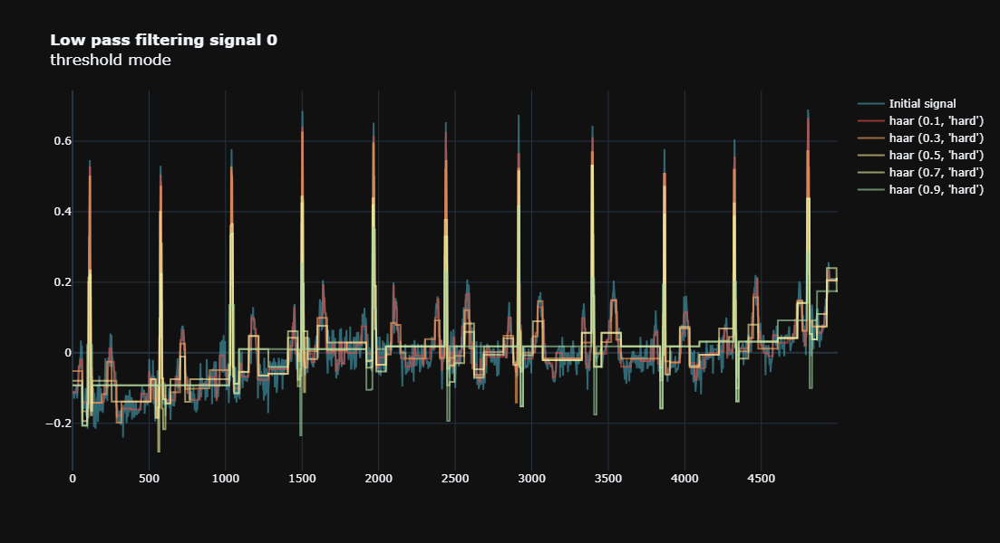

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|      haar      |       0.1       |       hard       |            28.6            |      0.05      |        16.9       |        0.06        |
|      haar      |       0.3       |       hard       |            23.4            |      0.15      |        47.2       |        0.02        |
|      haar      |       0.5       |       hard       |            19.3            |      0.29      |        84.7       |        0.01        |
|      haar      |       0.7       |       hard       |            17.8            |      0.42      |       131.6       |        0.01        |

In [92]:
###################
#   First test    #
###################
plot_wave_rec_lowpass(
    signal,
    ["haar"],
    np.linspace(0.1, 0.9, 5),
    ["hard"]
)

Here we can see the impact of the choice of pattern on the regularity of the reconstruction. The fact that Haar's base is piecewise continuous means that our reconstruction is too.
The threshold eliminates high-frequency coefficients, and the larger the threshold, the smaller the number of non-zero coefficients, as evidenced by the compression ratio. The result is a coarse approximation for high values, as measured by PSNR and NMSE.

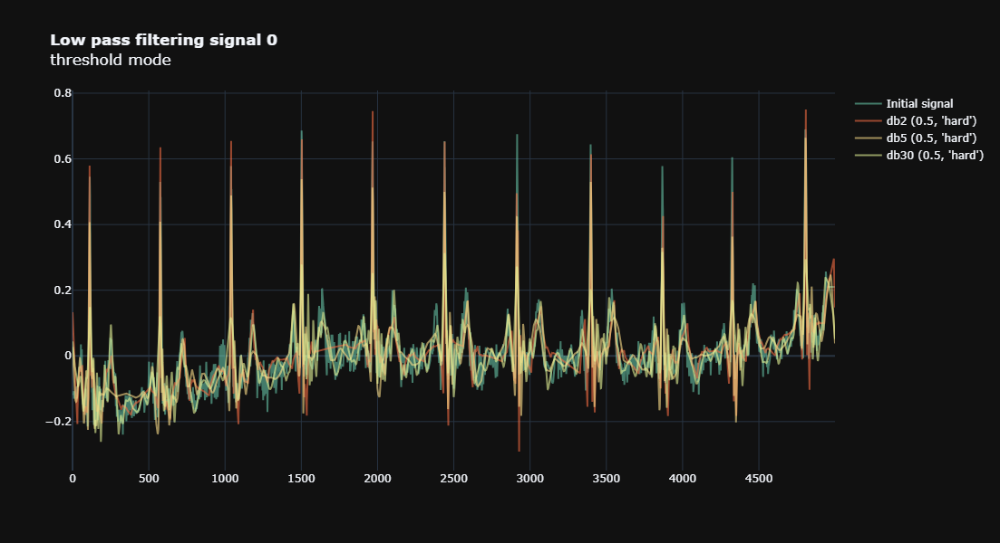

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|      db2       |       0.5       |       hard       |            23.0            |      0.24      |        74.6       |        0.01        |
|      db5       |       0.5       |       hard       |            21.7            |      0.25      |        74.6       |        0.01        |
|      db30      |       0.5       |       hard       |            13.6            |      0.39      |        45.5       |        0.01        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+

In [93]:
plot_wave_rec_lowpass(
    signal,
    ["db2", "db5", "db30"],
    [0.5],
    ["hard"]
)

Daubechies wavelets have the particularity of increasing regularity with their order, as with coiflettes and symmetrical wavelets. Unfortunately, this regularity is associated with a highly oscillating pattern, which in turn results in a more oscillating reconstruction analogous to Gibbs oscillations. In view of the signal we want to obtain (5 segments, 2 of which are not very regular), we're going to test low-order patterns.

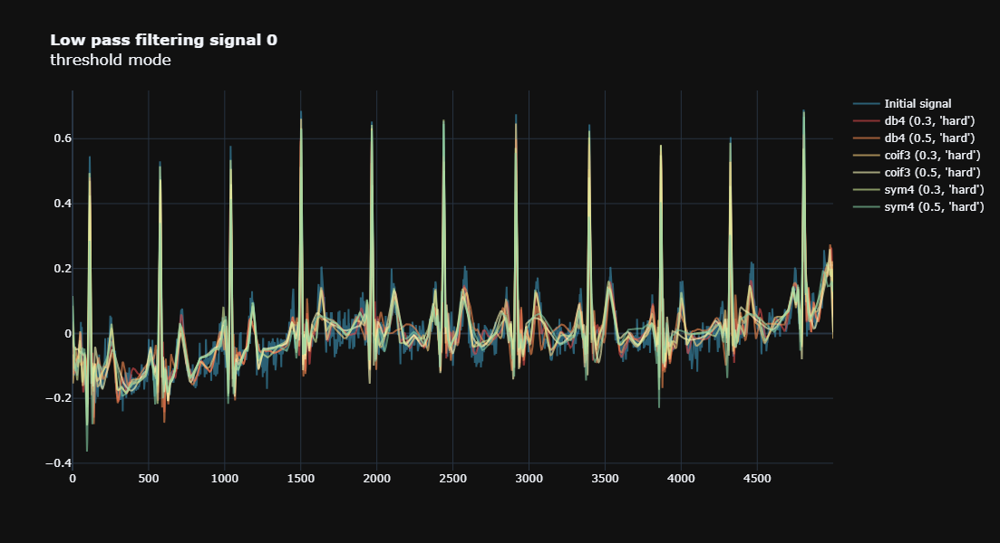

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|      db4       |       0.3       |       hard       |            24.2            |      0.12      |        42.0       |        0.02        |
|      db4       |       0.5       |       hard       |            21.0            |      0.24      |        67.6       |        0.01        |
|     coif3      |       0.3       |       hard       |            24.7            |      0.12      |        41.0       |        0.02        |
|     coif3      |       0.5       |       hard       |            20.5            |      0.25      |        66.7       |        0.01        |

In [94]:
plot_wave_rec_lowpass(
    signal,
    ["db4","coif3", "sym4"],
    np.linspace(0.3, 0.5, 2),
    ["hard"]
)

After a little research, we found satisfactory orders for the regularity of our mother wavelet. We have to admit that Daubechies' wavelets may not be the most relevant. Indeed, although the indicators are positive, we can see a more oscillating dynamic for the latter. This point is also borne out by the rest of the data.

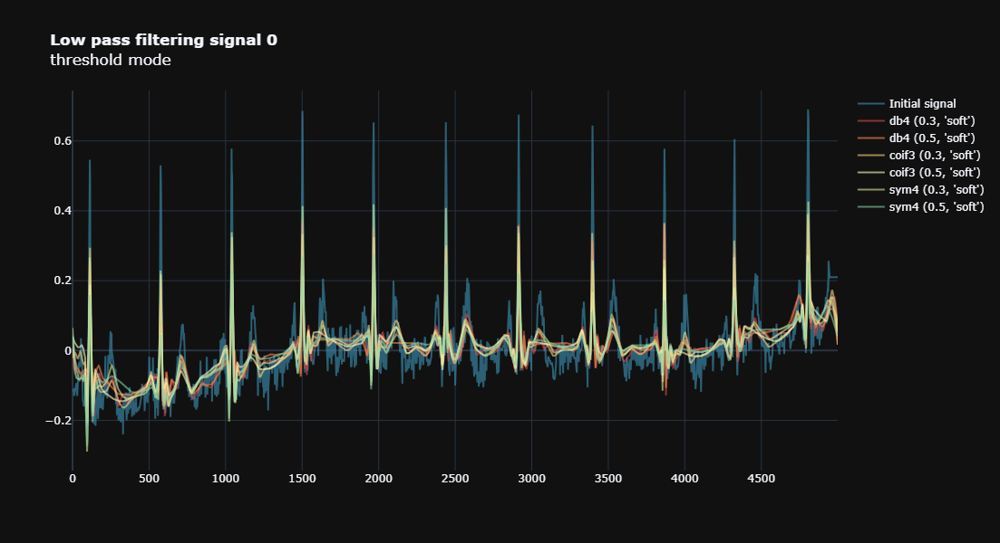

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|      db4       |       0.3       |       soft       |            16.2            |      0.23      |        42.0       |        0.02        |
|      db4       |       0.5       |       soft       |            9.7             |      0.49      |        67.6       |        0.01        |
|     coif3      |       0.3       |       soft       |            16.7            |      0.24      |        41.0       |        0.02        |
|     coif3      |       0.5       |       soft       |            11.2            |      0.47      |        66.7       |        0.01        |

In [95]:
plot_wave_rec_lowpass(
    signal,
    ["db4","coif3", "sym4"],
    np.linspace(0.3, 0.5, 2),
    ["soft"]
)

With the soft mode we've greatly smoothed out the small oscillations, which certainly increases the MSE but offers much better denoising.

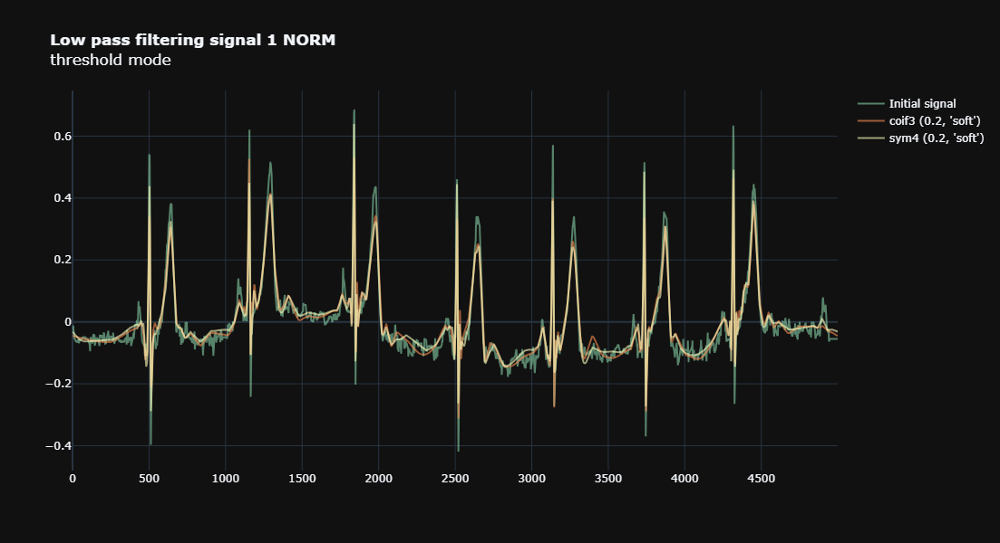

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            23.2            |      0.07      |        37.3       |        0.02        |
|      sym4      |       0.2       |       soft       |            24.8            |      0.06      |        41.3       |        0.02        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


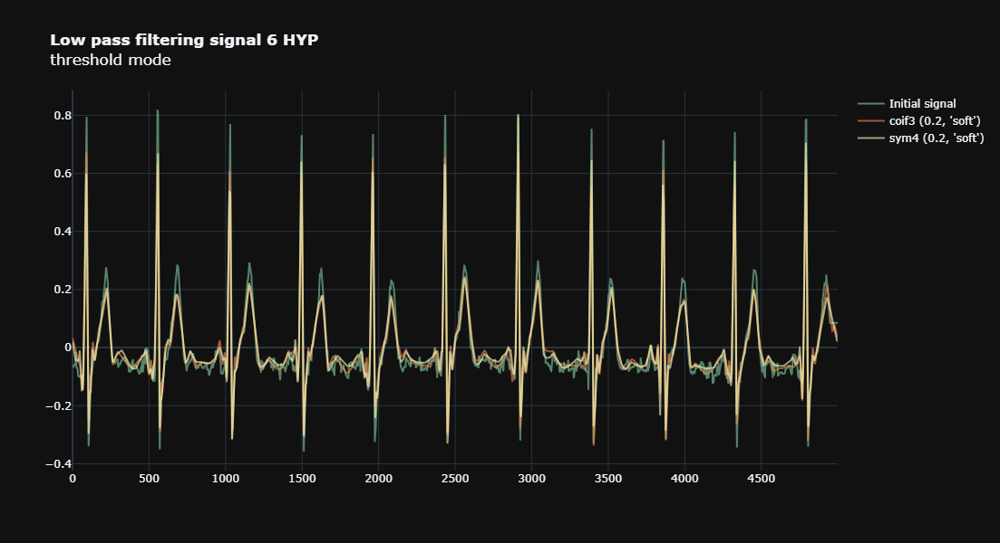

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            24.1            |      0.05      |        27.9       |        0.03        |
|      sym4      |       0.2       |       soft       |            25.6            |      0.04      |        28.7       |        0.03        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


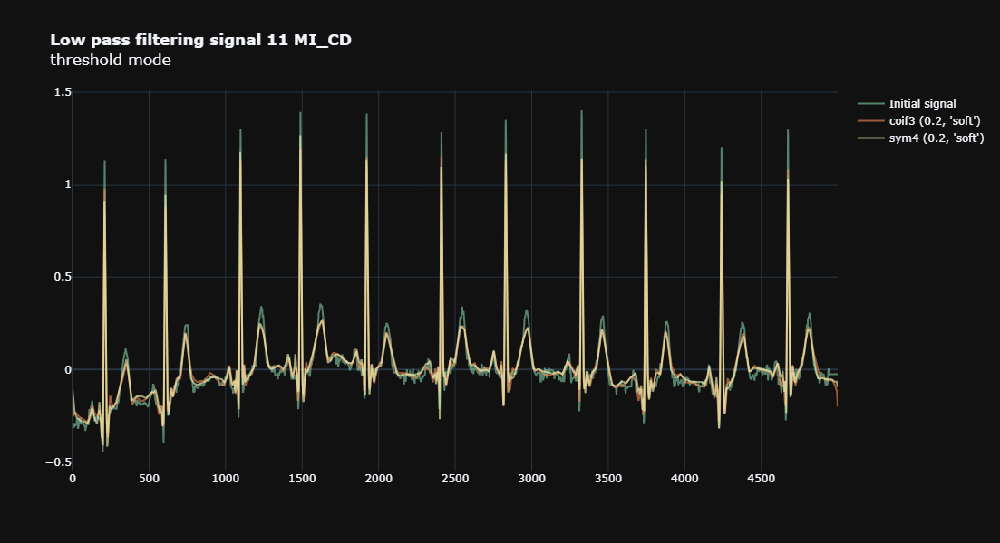

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            28.1            |      0.04      |        22.0       |        0.04        |
|      sym4      |       0.2       |       soft       |            28.7            |      0.04      |        25.3       |        0.04        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


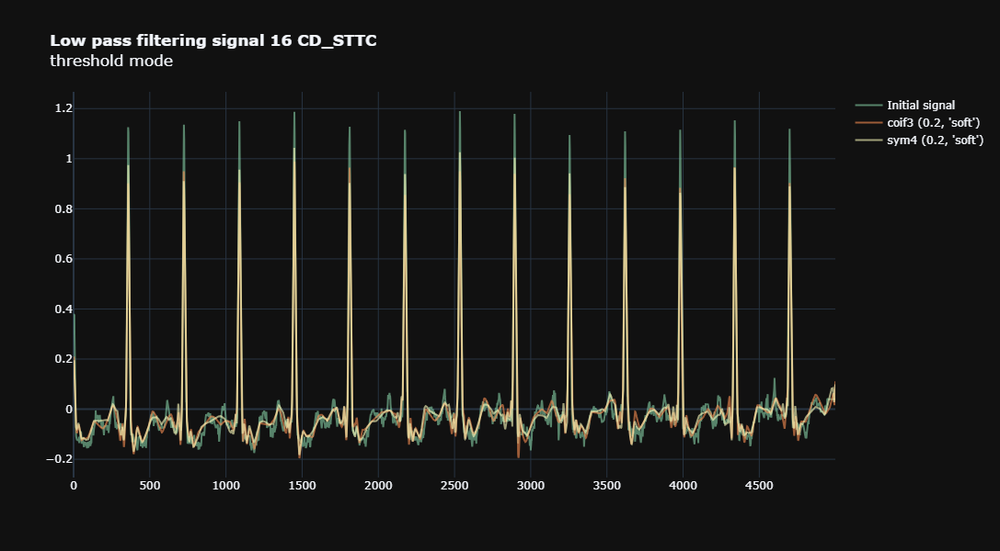

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            26.7            |      0.03      |        24.8       |        0.04        |
|      sym4      |       0.2       |       soft       |            27.2            |      0.04      |        25.6       |        0.04        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


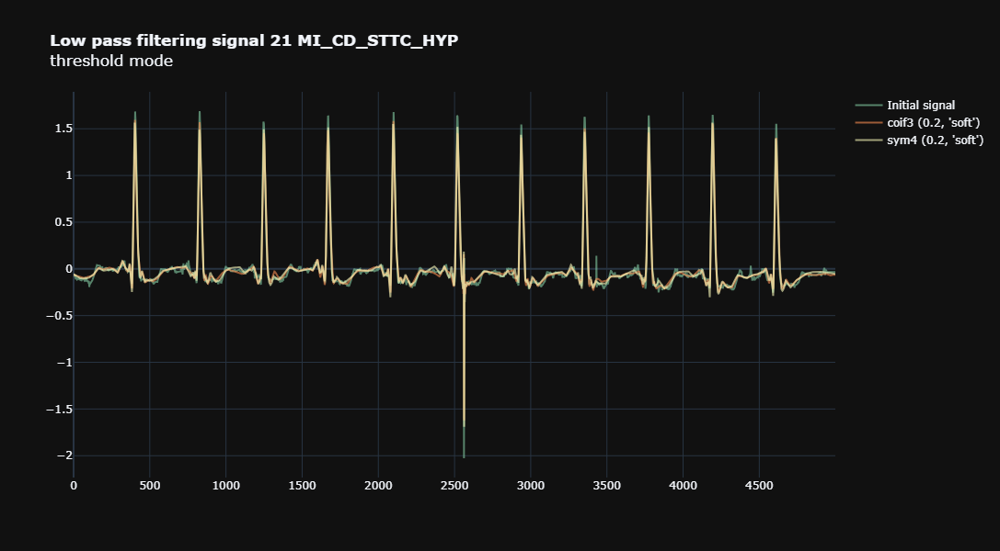

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            31.1            |      0.01      |        25.3       |        0.04        |
|      sym4      |       0.2       |       soft       |            30.7            |      0.01      |        23.9       |        0.04        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


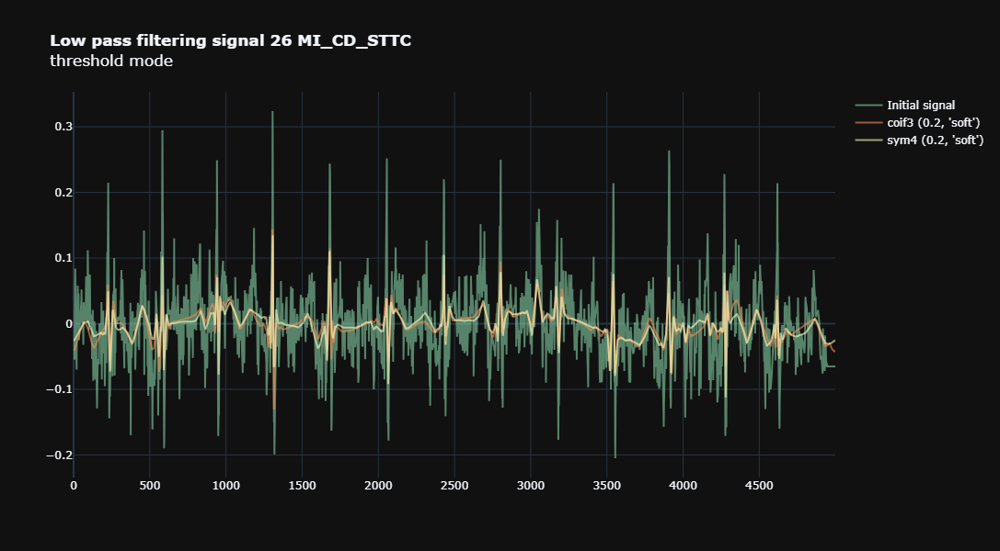

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            10.7            |      0.66      |        58.1       |        0.01        |
|      sym4      |       0.2       |       soft       |            10.2            |      0.62      |        59.5       |        0.01        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


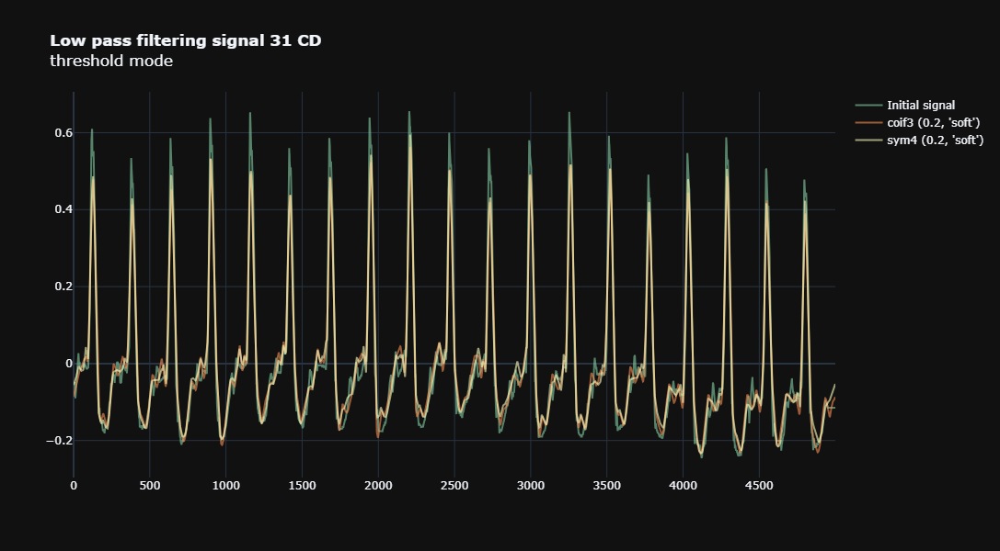

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            22.5            |      0.03      |        28.7       |        0.03        |
|      sym4      |       0.2       |       soft       |            23.1            |      0.03      |        31.1       |        0.03        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


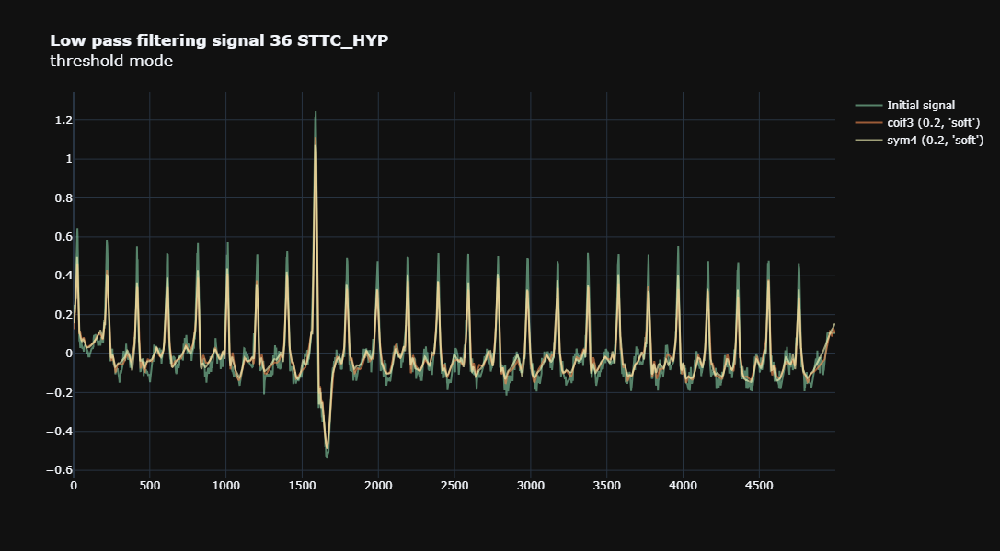

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            27.0            |      0.06      |        21.9       |        0.04        |
|      sym4      |       0.2       |       soft       |            26.5            |      0.07      |        22.5       |        0.04        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


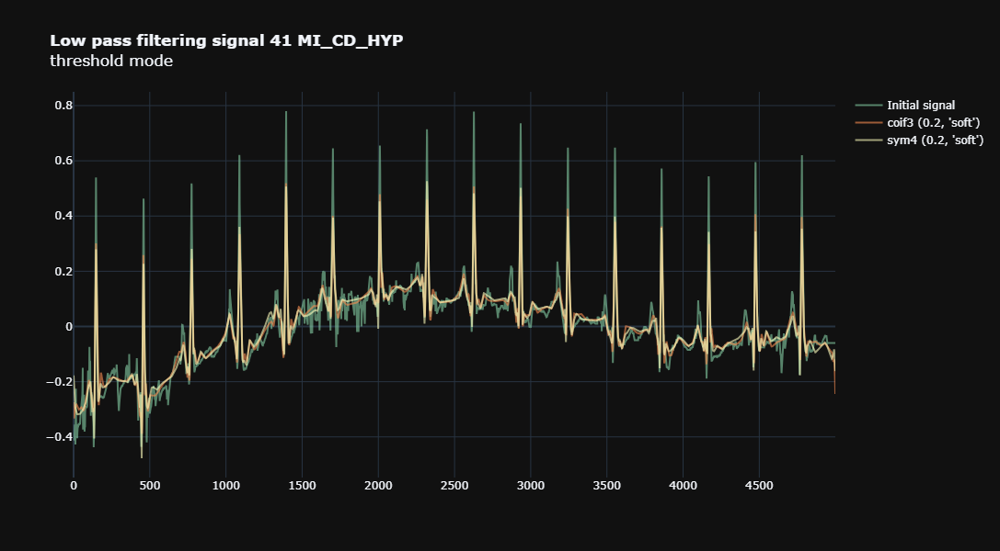

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            21.3            |      0.08      |        28.6       |        0.03        |
|      sym4      |       0.2       |       soft       |            21.3            |      0.08      |        29.8       |        0.03        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


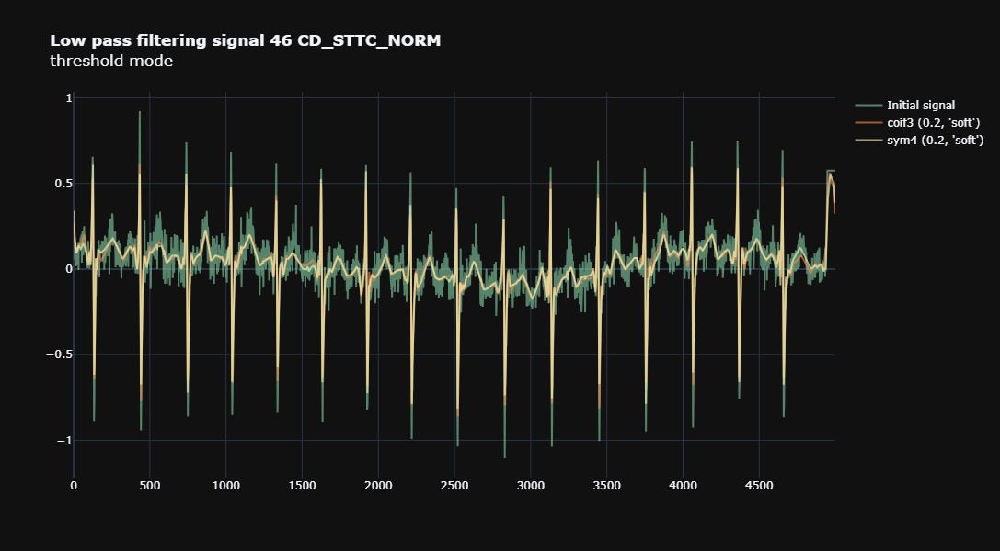

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            18.8            |      0.11      |        17.1       |        0.05        |
|      sym4      |       0.2       |       soft       |            18.7            |      0.12      |        17.7       |        0.05        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


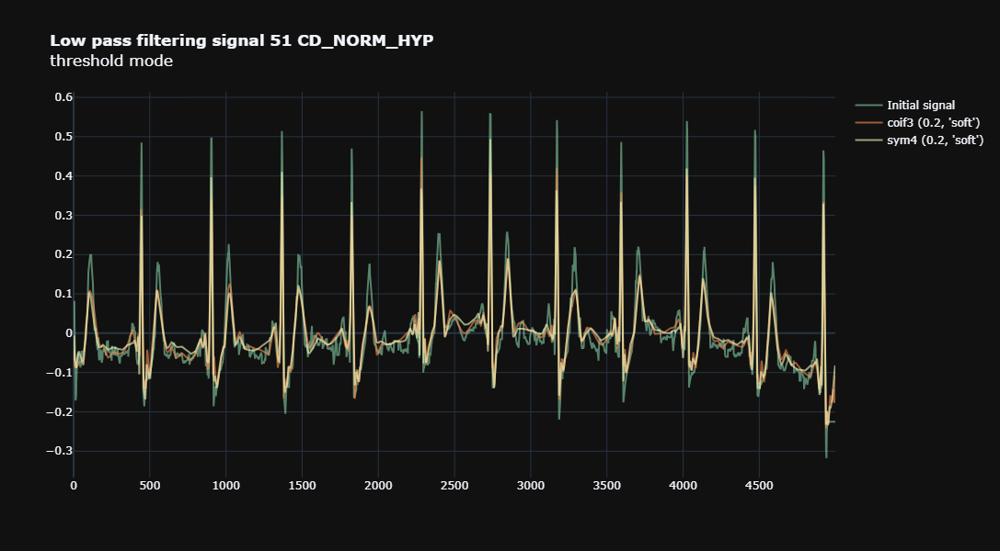

+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Threshold value | Threshold method | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |       0.2       |       soft       |            21.1            |      0.09      |        33.3       |        0.03        |
|      sym4      |       0.2       |       soft       |            21.7            |      0.09      |        34.7       |        0.03        |
+----------------+-----------------+------------------+----------------------------+----------------+-------------------+--------------------+


In [125]:
for i in range(1,55,5):
    diag = df_sub.iloc[i,6]
    plot_wave_rec_lowpass(
        signals0[i],
        ["coif3","sym4"],
        [0.2],
        ["soft"],
        name = f"signal {i} {diag}"
    )

At the end of this first analysis, we have chosen rather conservative thresholds. Indeed, our objective is not compression, but diagnostic assistance.
"coif3" is a bit smoother than "sym4" so the but gives poorer approximations. If we had to choose a filter it would be **"sym4" in "soft" mode with a threshold of 0.2**.

#### Proximal denoising

Here, a proximal method is used to address an optimization problem where we minimize the MSE with a spasity penalty on the wavelet coefficients.
Fisrt we need to compute the proximal based on the regularization function. 

In [110]:
def power_proximal(q, χ, ξ):
    """
    Compute the proximal of the power q function
    scaled to χ at point ξ
    
    Parameters
    ----------
    q : float
        Exponent in the power function
        Available: q = {1, 4/3, 3/2, 2, 3, 4}
        
    χ : float
        Regularization parameter
        
    ξ : float
        Point at which to compute the proximal operator
    
    Returns
    ---------
    prox : numpy.array
        Value of the proximal of the q power function
        at point ξ
    
    """
    Q_VALUES = [1.0, 4/3, 3/2, 2., 3., 4.]
    
    if q not in Q_VALUES:
        raise ValueError(f"q ({q}) does not belong in the expected "
                         f"values: {Q_VALUES}")
        
    prox = None
    
    if q == 1.0:
        prox = np.sign(ξ) * np.maximum(np.abs(ξ) - χ, 0)
    elif q == 4/3:
        ϵ = np.sqrt(ξ**2 + 256 / 729 * χ ** 3)
        prox = ξ + 4 * χ / (3 * 2 ** (1/3)) * ((ϵ - ξ) ** (1/3) - (ϵ + ξ) ** (1/3))
    elif q == 3/2:
        prox = ξ + 9 * χ ** 2 * np.sign(ξ) / 8 * (1 - np.sqrt(1 + 16 * np.abs(ξ) / (9 * χ ** 2)))
    elif q == 2:
        prox = ξ / (1 + 2 * χ)                    
    elif q == 3.:
        prox = np.sign(ξ) * (np.sqrt(1 + 12 * χ * np.abs(ξ)) - 1) / (6 * χ)
    elif q == 4.:
        ϵ = np.sqrt(ξ ** 2 + 1 / (27 * χ))
        prox = ((ϵ + ξ) / (8 * χ)) ** (1/3) - ((ϵ - ξ) / (8 * χ)) ** (1/3)
        
    return prox

def my_prox(coeff, arg0, arg1):
    return power_proximal(arg0, arg1, coeff)

def plot_wave_rec_prox(sign, waves, exponents, reg_parameters, name = "signal 0"):
    lst_args = list(product(waves, exponents, reg_parameters))
    table2 = PrettyTable([
        "Mother wavelet", 
        "Regul Exponent", 
        "Regul Parameter", 
        "Peak signal-to-noise ratio", 
        "Normalised MSE", 
        "Compression Ratio",
        "Zero ratio Tun Moe" 
    ])
    plot_wave_rec(
        sign,
        lst_args, 
        title = f"<b>Proximal filtering {name}</b><br>Exponent regularization-parameter", 
        f_filter = my_prox,
        table = table2
    )
       

Thanks to certain properties of the proximal, the optimum is reached when the proximal is applied to each of the coefficients before reconstruction. Note that this is analogous to a filtering method.

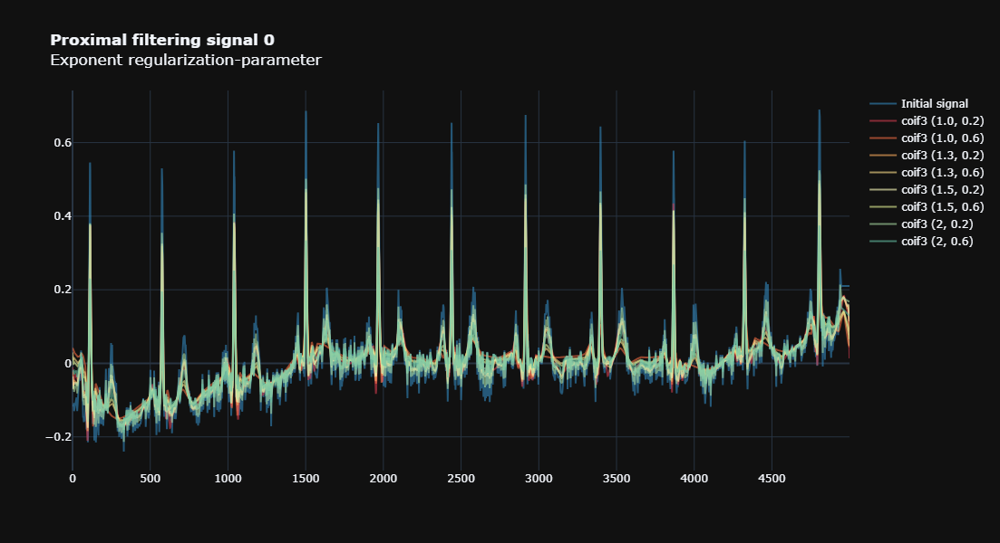

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            20.0            |      0.15      |        29.8       |        0.03        |
|     coif3      |      1.0       |       0.6       |            8.4             |      0.59      |        84.7       |        0.01        |
|     coif3      |      1.3       |       0.2       |            22.1            |      0.08      |        1.0        |        1.0         |
|     coif3      |      1.3       |       0.6       |            11.8            |      0.38      |        1.0        |        1.0         |
|     coif3  

In [119]:
plot_wave_rec_prox(
    signal,
    ["coif3"],
    [1.0, 4/3, 3/2,2],
    np.linspace(2e-1, 6e-1, 2)
)

Regularizations by p-norme with p greater than 4/3 are not parsimonious enough to eliminate noise. And this remains true even with a high regularization parameter. An exponent of 1 seems to be the best choice to have avoid small oscillations. Note that the proximal for this exponent is close to the threshold function in soft mode.

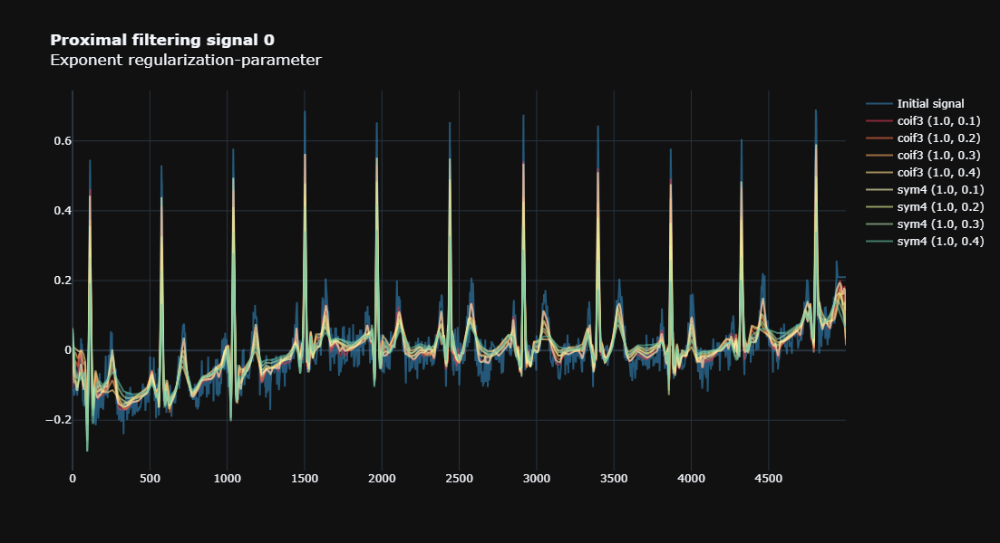

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.1       |            25.2            |      0.07      |        17.4       |        0.05        |
|     coif3      |      1.0       |       0.2       |            20.0            |      0.15      |        29.8       |        0.03        |
|     coif3      |      1.0       |       0.3       |            16.7            |      0.24      |        41.0       |        0.02        |
|     coif3      |      1.0       |       0.4       |            14.0            |      0.34      |        53.8       |        0.01        |
|      sym4  

In [123]:
plot_wave_rec_prox(
    signal,
    ["coif3", "sym4"],
    [1.0],
    np.linspace(1e-1, 4e-1, 4)
)

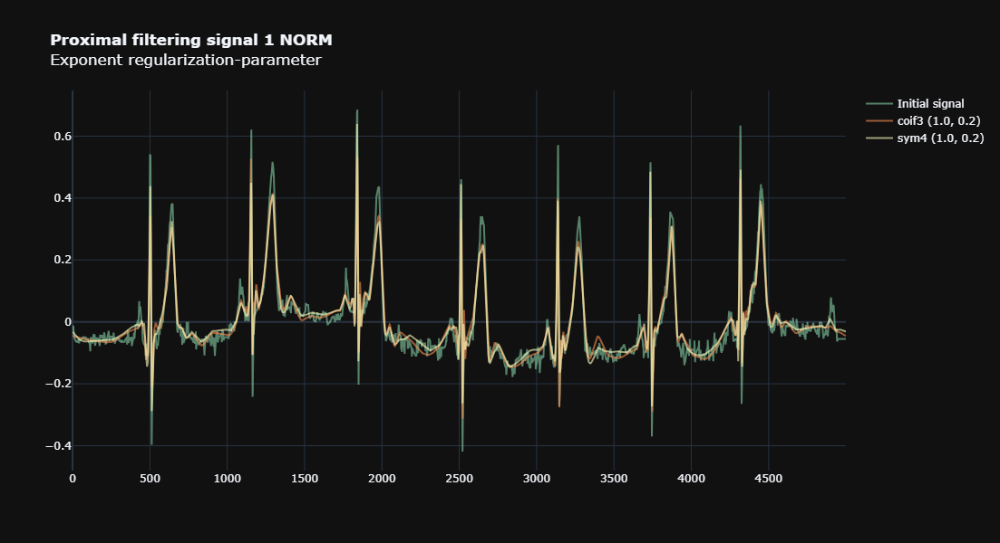

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            23.2            |      0.07      |        37.3       |        0.02        |
|      sym4      |      1.0       |       0.2       |            24.8            |      0.06      |        41.3       |        0.02        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


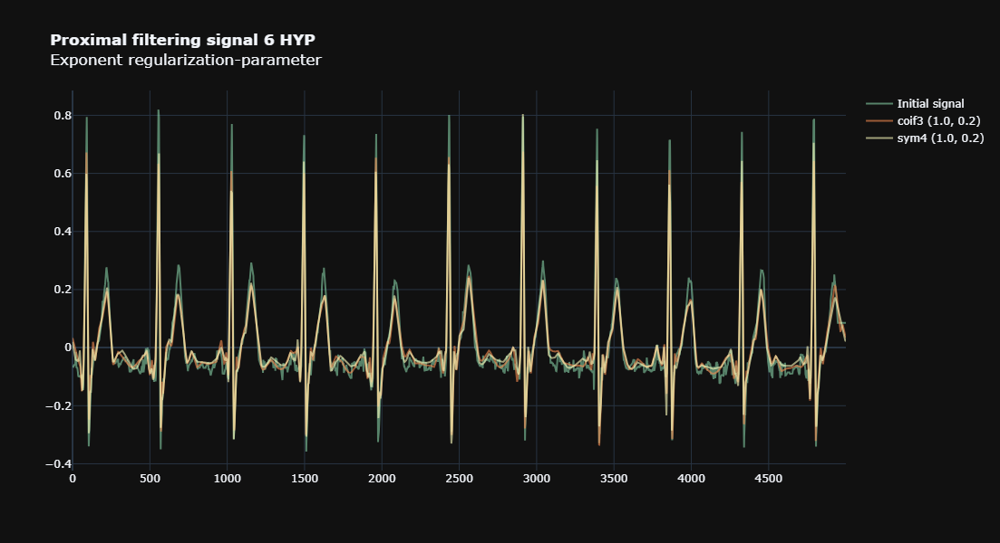

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            24.1            |      0.05      |        27.9       |        0.03        |
|      sym4      |      1.0       |       0.2       |            25.6            |      0.04      |        28.7       |        0.03        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


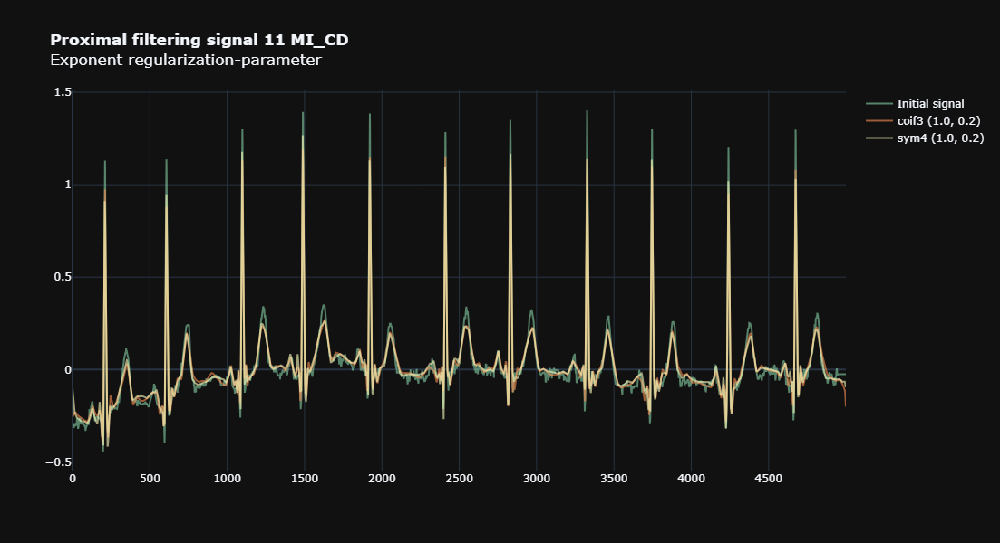

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            28.1            |      0.04      |        22.0       |        0.04        |
|      sym4      |      1.0       |       0.2       |            28.7            |      0.04      |        25.3       |        0.04        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


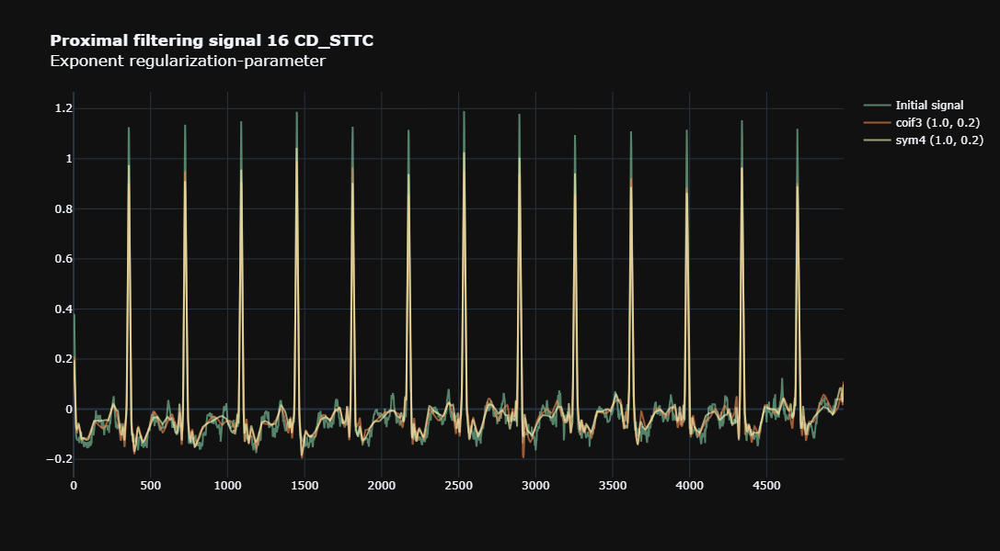

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            26.7            |      0.03      |        24.8       |        0.04        |
|      sym4      |      1.0       |       0.2       |            27.2            |      0.04      |        25.6       |        0.04        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


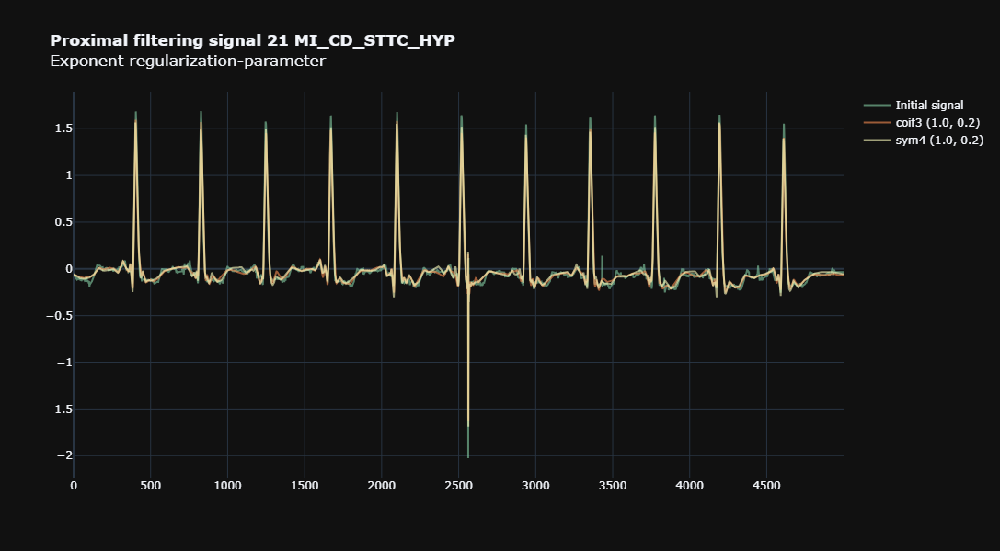

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            31.1            |      0.01      |        25.3       |        0.04        |
|      sym4      |      1.0       |       0.2       |            30.7            |      0.01      |        23.9       |        0.04        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


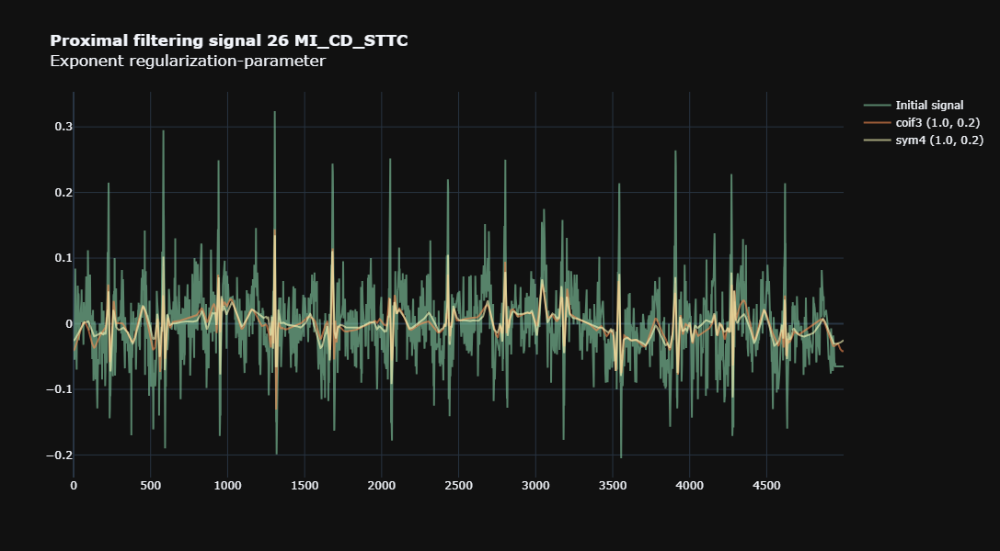

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            10.7            |      0.66      |        58.1       |        0.01        |
|      sym4      |      1.0       |       0.2       |            10.2            |      0.62      |        59.5       |        0.01        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


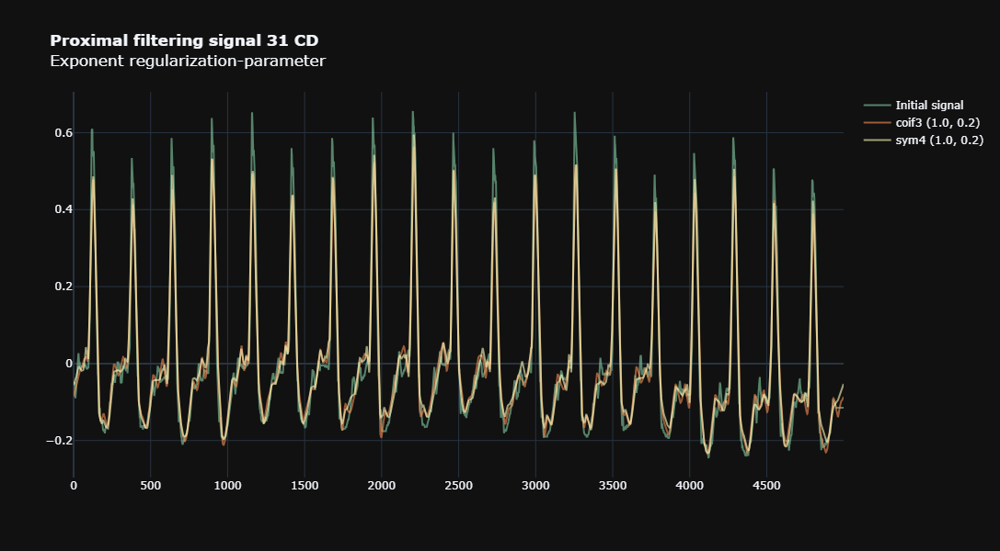

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            22.5            |      0.03      |        28.7       |        0.03        |
|      sym4      |      1.0       |       0.2       |            23.1            |      0.03      |        31.1       |        0.03        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


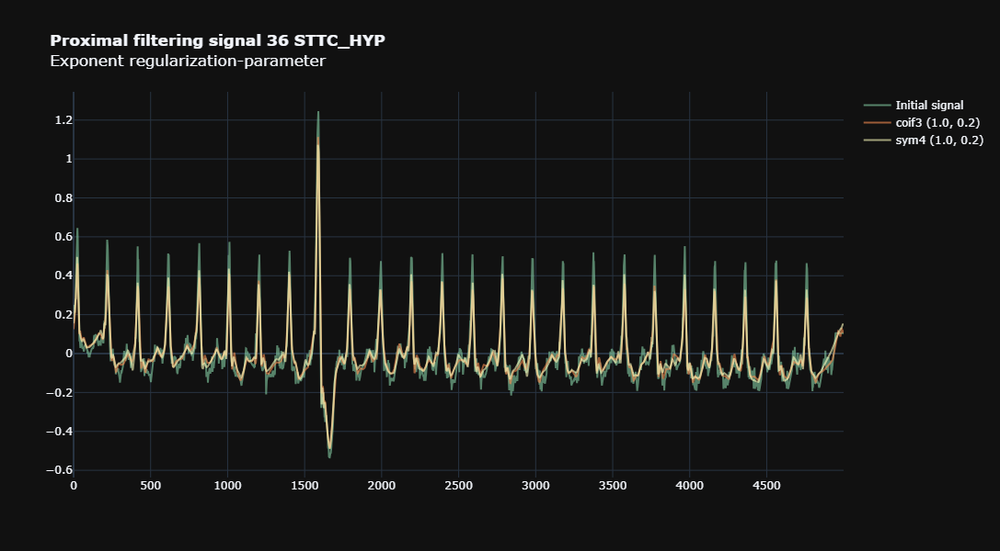

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            27.0            |      0.06      |        21.9       |        0.04        |
|      sym4      |      1.0       |       0.2       |            26.5            |      0.07      |        22.5       |        0.04        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


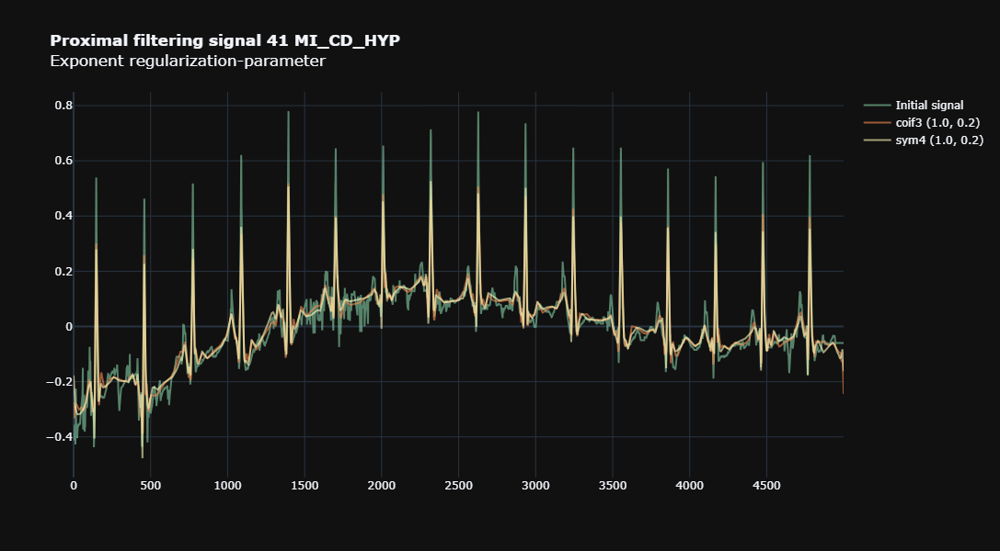

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            21.3            |      0.08      |        28.6       |        0.03        |
|      sym4      |      1.0       |       0.2       |            21.3            |      0.08      |        29.8       |        0.03        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


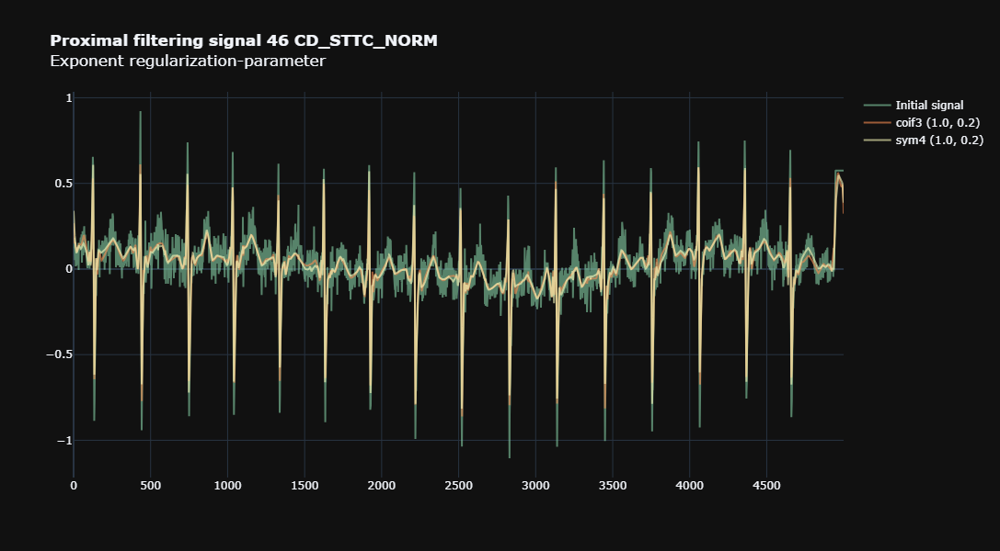

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            18.8            |      0.11      |        17.1       |        0.05        |
|      sym4      |      1.0       |       0.2       |            18.7            |      0.12      |        17.7       |        0.05        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


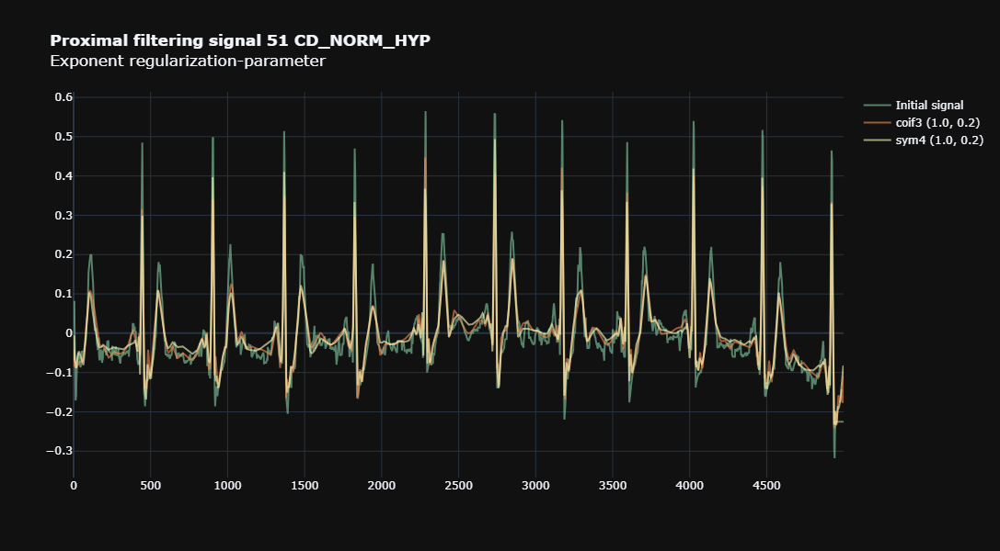

+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
| Mother wavelet | Regul Exponent | Regul Parameter | Peak signal-to-noise ratio | Normalised MSE | Compression Ratio | Zero ratio Tun Moe |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+
|     coif3      |      1.0       |       0.2       |            21.1            |      0.09      |        33.3       |        0.03        |
|      sym4      |      1.0       |       0.2       |            21.7            |      0.09      |        34.7       |        0.03        |
+----------------+----------------+-----------------+----------------------------+----------------+-------------------+--------------------+


In [124]:
for i in range(1,55,5):
    diag = df_sub.iloc[i,6]
    plot_wave_rec_prox(
        signals0[i],
        ["coif3","sym4"],
        [1.0],
        [0.2],
        name = f"signal {i} {diag}"
    )

Here again, if we had to choose a filter it would be **"sym4" with l1 norm and 0.2** as regularization's parameter.

#### Scalograme interpretations

In [148]:
def best_denoised(sign, f_filter):
    #decomposition
    coeffs = pywt.wavedec(sign, "sym4", mode="per")
    #filtration
    if f_filter.__name__ == "my_prox":
        args_filter = (1,0.2)
    else:
        print(f_filter.__name__)
        args_filter = (0.2,"soft")
    
    coeffs[1:] = (f_filter(coeff, *args_filter) for coeff in coeffs[1:])
    #reconstruction
    return pywt.waverec(coeffs, "sym4", mode="per" )

def plot_scalogram_best_denoised(sign, scales):
    f_plot = lambda sig, title: plot_scalogram_freq(
        sig, 
        scales, 
        waveletname = 'cmor', 
        title = title, 
        levels = np.linspace(1e-1, 4, 40)
    )
    f_plot(sign, f"Scalograme original signal")
    f_plot(best_denoised(sign, my_threshold), f"Scalograme soft threshold sym4 (0.2)")
    f_plot(best_denoised(sign, my_prox), f"Scalograme proximal sym4 (1 0.2)")

C:\Users\samud\anaconda3\envs\MVA\lib\site-packages\pywt\_cwt.py:117: FutureWarning:

Wavelets from the family cmor, without parameters specified in the name are deprecated. The name should takethe form cmorB-C where B and C are floats representing the bandwidth frequency and center frequency, respectively (example: cmor1.5-1.0).

C:\Users\samud\AppData\Local\Temp\ipykernel_26024\3297400880.py:141: RuntimeWarning:

divide by zero encountered in log2



<Figure size 640x480 with 0 Axes>

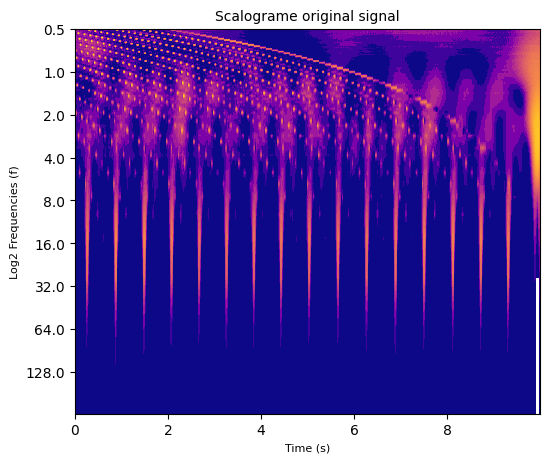

my_threshold


C:\Users\samud\anaconda3\envs\MVA\lib\site-packages\pywt\_cwt.py:117: FutureWarning:

Wavelets from the family cmor, without parameters specified in the name are deprecated. The name should takethe form cmorB-C where B and C are floats representing the bandwidth frequency and center frequency, respectively (example: cmor1.5-1.0).



<Figure size 640x480 with 0 Axes>

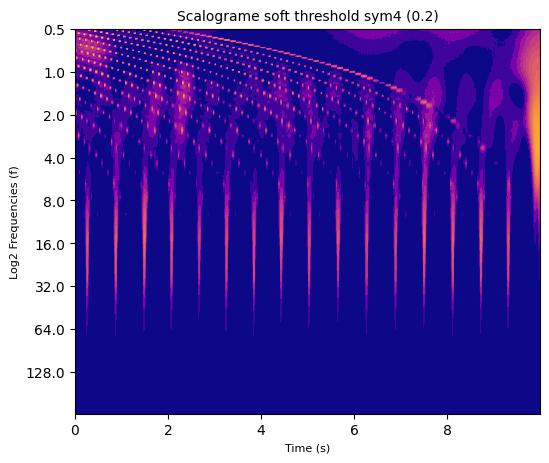

C:\Users\samud\anaconda3\envs\MVA\lib\site-packages\pywt\_cwt.py:117: FutureWarning:

Wavelets from the family cmor, without parameters specified in the name are deprecated. The name should takethe form cmorB-C where B and C are floats representing the bandwidth frequency and center frequency, respectively (example: cmor1.5-1.0).



<Figure size 640x480 with 0 Axes>

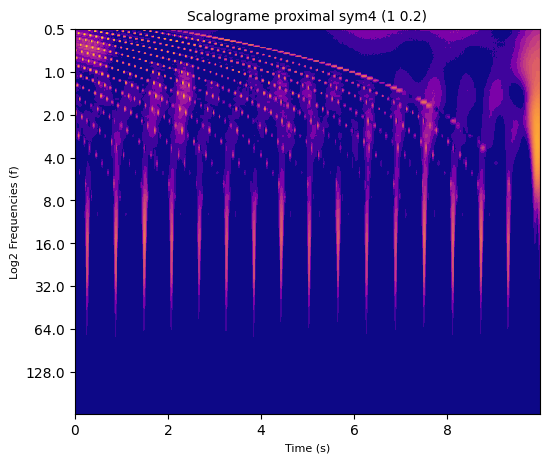

In [149]:
plot_scalogram_best_denoised(signals0[46], scales)

The scalograms show us that our two selectioned approaches are exactly the same. The high-frequency structures are not associated with noise but the but the main peaks. It's mainly the values around the singularities that make up the noise.

## Appendix Data selection

### Functions for data manipulation

In [ ]:

################
#   loading    #
################
def load_meta(root_path):
    """
    Load metadata related to electrocardiogram (ECG) data.

    Args:
        root_path (str or Path): Root path containing the 'raw_data' directory.

    Returns:
        dict: Dictionary containing loaded dataframes.
            - 'ecg_meta': Metadata related to ECG data.
            - 'scp': SCP statements dataframe.
    """
    
    meta_path = root_path.joinpath("raw_data", "meta_data")
    ecg_path = str(meta_path.joinpath('ptbxl_database.csv'))
    scp_path = str(meta_path.joinpath('scp_statements.csv'))
    
    df_ecg_meta = pd.read_csv(ecg_path, index_col='ecg_id')
    df_ecg_meta.scp_codes = df_ecg_meta.scp_codes.apply(lambda x: ast.literal_eval(x))
    
    return  {"ecg_meta": df_ecg_meta,
              "scp": pd.read_csv(scp_path, index_col=0)
              }
    
def load_ecg(dct_data, root_path, sampling_rate=100, ecg_ids=None):
    """
    Load electrocardiogram (ECG) data based on metadata.

    Args:
        dct_data (dict): Dictionary containing data.
        root_path (str or Path): Root path containing the 'raw_data' directory.
        sampling_rate (int): Sampling rate of the ECG data.
        ecg_ids (list or None): List of ECG IDs to load. If None, load all.

    Returns:
        None: Updates the 'ecg' key in dct_data with loaded ECG data.
    """
    df_ecg_meta = dct_data["ecg_meta"]
    ecg_path = root_path.joinpath("raw_data","ecg_data")
    
    if sampling_rate == 100:
        col = "filename_lr"
    else:
        col = "filename_hr"
    if ecg_ids:
        filenames = df_ecg_meta.loc[ecg_ids, col]
    else:
        filenames = df_ecg_meta[col]
    
    print(filenames)
    load_signal = lambda path : wfdb.rdsamp(
        str(ecg_path.joinpath(path))
        )[0] 

    
    dct_data["ecg"] = filenames.apply(load_signal).to_numpy()


def load_ecg_from_clean_data(df_clean, root_path, patient_ids=None, nsig = None):
    ecg_path = root_path.joinpath("raw_data","ecg_data")
    load_signal = lambda path : wfdb.rdsamp(
        str(ecg_path.joinpath(path))
        )[0] 
    if patient_ids:
        filenames = df_clean.loc[df_clean["patient_id"].isin(patient_ids), "filename_hr"]
    else:
        filenames = df_clean["filename_hr"]
    signals = filenames.apply(load_signal).to_numpy()
    print("signals shapes: ", signals.shape)
    return signals, df_clean.loc[df_clean["patient_id"].isin(patient_ids), "patient_id"]

#######################
#   get superclass    #
#######################

def aggregate_diagnostic(agg_df, y_dic):
    tmp = []
    for key in y_dic.keys():
        if key in agg_df.index:
            tmp.append(agg_df.loc[key].diagnostic_class)
    return list(set(tmp))

def add_superclasse(dct_data):
    agg_df = dct_data["scp"].copy()
    agg_df = agg_df[agg_df.diagnostic == 1]
    f_agg = lambda y_dic: aggregate_diagnostic(agg_df, y_dic)
    dct_data["ecg_meta"]['diagnostic_superclass'] = dct_data["ecg_meta"].scp_codes.apply(f_agg)
    


############################
#   raw data description   #
############################

def df_nan_percent(df: pd.DataFrame) -> pd.DataFrame:
    """
    Calcule le pourcentage de valeurs manquantes dans chaque colonne d'un DataFrame.

    Args:
        df (pd.DataFrame): DataFrame contenant les données.

    Returns:
        pd.DataFrame: DataFrame contenant le pourcentage de valeurs manquantes pour chaque colonne.
    """
    part_nan = df.isnull().mean()
    perc_nan = pd.DataFrame(np.round(100 * part_nan.to_numpy(), 1))
    perc_nan.index = part_nan.index
    return perc_nan

def describ_raw_df(df):
    print("\n---------Shape------------------\n", df.shape)
    print("\n---------Types------------------\n", df.dtypes)
    print("\n--------- 1 row-----------------\n", df.iloc[0, :])
    print("\n---------describe---------------\n", df.describe())
    print("\n---------nan percentage---------\n", df_nan_percent(df))
    for col in df:
        unique_val = df[col].explode().unique()
        if len(unique_val) < 20:
            print(f"\n---------{col} values----------")
            print(unique_val)
            

############################
#   get selection by diag  #
############################

def get_npatients_by_diag(df_clean, npatients = 1):
    lst_example_signal = []
    for diag in np.unique(df_clean["diag"]):
        lst_example_signal.append(df_clean.loc[df_clean["diag"]==diag, "patient_id"][:npatients])
    return np.concatenate(lst_example_signal)

def get_diag(df, patients):
    return df.loc[df["patient_id"].isin(patients), "diag"]

### Script to create and analyse the given databases

In [ ]:
###############
# csv loading #
###############
dct_data = load_meta(root_path)
add_superclasse(dct_data)

####################
# csv descriptions #
####################
describ_raw_df(dct_data["ecg_meta"])
describ_raw_df(dct_data["scp"])

##############################
# columns and rows selctions #
##############################
# patient_id                      float64
# age                             float64
# sex                               int64
# height                          float64
# weight                          float64
# nurse                           float64
# site                            float64
# device                           object
# recording_date                   object
# report                           object
# scp_codes                        object
# heart_axis                       object
# infarction_stadium1              object
# infarction_stadium2              object
# validated_by                    float64
# second_opinion                     bool
# initial_autogenerated_report       bool
# validated_by_human                 bool
# baseline_drift                   object
# static_noise                     object
# burst_noise                      object
# electrodes_problems              object
# extra_beats                      object
# pacemaker                        object
# strat_fold                        int64
# filename_lr                      object
# filename_hr                      object
# diagnostic_superclass            object

patient_var = ["patient_id", "age", "sex", "height", "weight", "filename_hr", "diagnostic_superclass"]
bin1 = dct_data["ecg_meta"]["validated_by_human"]
bin2 = dct_data["ecg_meta"]["diagnostic_superclass"].notna()
bin3 = dct_data["ecg_meta"]["electrodes_problems"].isna()
selection = bin1 * bin2 * bin3 == 1

print("enlevés: ",(1-selection).sum())
print("conservés: ",selection.sum())
######################
# Diagnostic merging #
######################
df = dct_data["ecg_meta"].loc[selection,patient_var]
# diagnostic join 
df["diag"] = df["diagnostic_superclass"].apply("_".join)
patient_var.remove("diagnostic_superclass")
patient_var.append("diag")
# select only patients with diagnostics
df = df.loc[df["diag"] != "", patient_var].astype(str)

######################
# Patients selection #
######################
#get 2 patients per diagostic
patient_ids = get_npatients_by_diag(df, npatients=2)
#load the associated data
signals, patients = load_ecg_from_clean_data(df, root_path, patient_ids = patient_ids.tolist())

#######################
# Electrode selection #
#######################
#plot signals by electrode

dct_signals = {k:  [ sigs[:,k] for sigs in signals ]  for k in range(12)}
for k,sigs in dct_signals.items():
    plot_all_st(sigs[::2], clustering=None, title=f"<b>Signals 500Hz</b> electrode {k}")

signals0 = np.array([ sigs[:,0] for sigs in signals ])

##########
# Saving #
##########

with open(str(saving_path.joinpath("signals0.pkl")), "wb") as f:
    pickle.dump(signals0, f)

with open(str(saving_path.joinpath("meta_data.pkl")), "wb") as f:
    pickle.dump(df, f)

#####################
# Raw data analysis #
#####################
#meta description
df_sub[[ "age", "sex", "height", "weight"]] = df_sub[[ "age", "sex", "height", "weight"]].astype(float)
describ_raw_df(df_sub)

#Signals plotting
fig = go.Figure(
        layout=go.Layout(
            height=600, 
            width=800, 
            template = "plotly_dark", 
            title = f"Signals 500Hz electrode 0"
    ))
pal = my_pal(signals0.shape[0])

for i,sign in enumerate(signals0):
    diag = df_sub.iloc[i,6]
    add_fig(fig, sign, pal[i] ,f"{diag}")
fig.show()

## Appendix Wavelets

### Wavelets mothers and fathers

In [ ]:
level = 5

lst_types = pywt.families()
sep_continous = lst_types.index("gaus")

lst_discret = lst_types[:sep_continous]
lst_continuous = lst_types[sep_continous:]

for type in lst_discret:
    plot_wave_family(level, type, iscontinous = False)
    
for type in lst_continuous:
    plot_wave_family(level, type, iscontinous = True)

### Discrete Wavelet Transform

In [ ]:
approx, detail = pywt.dwt(signal, 'db2')

plot_signal(approx, title = "Approximation coefficients")
plot_signal(detail, title = "Details coefficients")

In [ ]:
plot_reconstruct = lambda app, det, title: plot_estim(pywt.idwt(app, det, 'db2'), signal, title = title)

plot_reconstruct(approx, detail, "reconstruction")
plot_reconstruct(approx, np.zeros_like(detail), "reconstruction without details")
plot_reconstruct(np.zeros_like(approx), detail, "reconstruction without approx")

In [ ]:
w = pywt.DiscreteContinuousWavelet("haar")
plot_decomposition(w, title=f"Wavelets multilevel reconstruction")

### Wavelet packet

In [ ]:
wp = pywt.WaveletPacket(data=signal, wavelet=w)
lst_coeffs_by_f = [node.path for node in wp.get_level(wp.maxlevel, 'freq')]
print(lst_coeffs_by_f[:10])

In [ ]:
# Test d'une reconstruction
wp2 = pywt.WaveletPacket(data=None, wavelet=w)
for i,node in enumerate(lst_coeffs_by_f):
    if i<10:
        wp2[node] = wp[node].data
    else:
        wp2[node] = np.zeros_like(wp[node].data)